# Tensorflow with GPU

This notebook provides an introduction to computing on a [GPU](https://cloud.google.com/gpu) in Colab. In this notebook you will connect to a GPU, and then run some basic TensorFlow operations on both the CPU and a GPU, observing the speedup provided by using the GPU.


In [1]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
import glob
import pandas as pd
import numpy as np
import cv2
import imageio
import matplotlib.pyplot as plt 
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.models import *
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.applications import VGG16
from tensorflow.keras.callbacks import *
from tensorflow.nn import depth_to_space
from keras import backend as K
from IPython import display
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
path='/content/drive/MyDrive/Ass4_DL/JPEGImages/'
gif_path='/content/drive/MyDrive/Ass4_DL/'

In [3]:
filelist=glob.glob(path+'*.jpg')
def split_data(filelist, split_value):
  tr_data = []
  val_data = []
  for i in range(len(filelist)):
    if i > 1000:
      tr_data.append(filelist[i])
    else:
      val_data.append(filelist[i])
  return tr_data, val_data
tr_data, val_data = split_data(filelist, 1000)
len(tr_data), len(val_data)

(4019, 1001)

In [5]:
df_results = pd.DataFrame({})
N_epoches = 50
batch_split = 8

In [43]:
def add_result(df_results, history, step):
  if step==2:
    total_val_loss = np.nan
    val_loss_144 =  np.min(history['val_loss'])
    val_loss_288 = np.nan
    val_PSNR_144 = np.max(history['val_PSNR'])
    val_PSNR_288 = np.nan
    row = {'Step':[step], 'Total_val_loss':[total_val_loss], 'val_loss_144':[val_loss_144], 'val_loss_288':[val_loss_288], 'val_PSNR_144':[val_PSNR_144], 'val_PSNR_288':[val_PSNR_288]}
    return pd.DataFrame(data=row)
  total_val_loss = np.min(history['val_loss'])
  val_loss_144 =  np.min(history['val_out_144_loss'])
  val_loss_288 =  np.min(history['val_out_288_loss'])
  val_PSNR_144 = np.max(history['val_out_144_PSNR'])
  val_PSNR_288 = np.max(history['val_out_288_PSNR'])
  row = [step, total_val_loss, val_loss_144, val_loss_288, val_PSNR_144, val_PSNR_288]
  df_results.loc[step-2] = row
  return df_results
    
  



In [7]:
def save_gif(gif_path, step, pred_pics):
  pics = list((pic[0]*255).astype(np.uint8) for pic in pred_pics)
  imageio.mimsave(gif_path + step + '_mygif.gif', np.array(pics), fps = 3, format='GIF-PIL')
def save_gifs(gif_path, step, pred_pics):
  pics_144 = list((pic[0][0]*255).astype(np.uint8) for pic in pred_pics)
  pics_288 = list((pic[1][0]*255).astype(np.uint8) for pic in pred_pics)
  imageio.mimsave(gif_path + step + '_144_mygif.gif', np.array(pics_144), fps = 3, format='GIF-PIL')
  imageio.mimsave(gif_path + step + '_288_mygif.gif', np.array(pics_288), fps = 3, format='GIF-PIL')

In [8]:
def plot_multiple_images(images_list, titles=[]):
  size = len(images_list)
  title = ""
  fig,ax = plt.subplots(1,size,figsize=(size*8,8))
  for i in range(len(images_list)):
    ax[i].imshow(images_list[i])
    if len(titles)==size:
      ax[i].set_title(titles[i], fontsize = 22)

In [10]:
def plot_model_144(model_hist):
        tr_PSNR = model_hist.history['PSNR']
        val_PSNR = model_hist.history['val_PSNR']
        tr_loss = model_hist.history['loss']
        val_loss = model_hist.history['val_loss']

        epochs = range(1, len(tr_loss) + 1)

        plt.figure(figsize=(15, 6));
        plt.subplot(1, 2, 1)
        plt.plot(epochs, tr_PSNR, color='#F90F04', linestyle='dashed', label='Training PSNR')
        plt.plot(epochs, val_PSNR, color='#F90F04', linestyle='solid', label='Validation PSNR')
        plt.title('Training and Validation PSNR')
        plt.legend(loc='best')
        plt.xlabel('Epochs')
        plt.ylabel('PSNR')

        plt.subplot(1, 2, 2)
        plt.plot(epochs, tr_loss, color='#194DE1', linestyle='dashed', label='Training Loss')
        plt.plot(epochs, val_loss, color='#194DE1', linestyle='solid', label='Validation Loss')
        plt.title('Training and Validation Loss')
        plt.legend(loc='best')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')

        plt.show()

def plot_model_288(model_hist):
        tr_PSNR_144 = model_hist.history['out_144_PSNR']
        val_PSNR_144 = model_hist.history['val_out_144_PSNR']
        tr_PSNR_288 = model_hist.history['out_288_PSNR']
        val_PSNR_288 = model_hist.history['val_out_288_PSNR']

        tr_loss_144 = model_hist.history['out_144_loss']
        val_loss_144 = model_hist.history['val_out_144_loss']
        tr_loss_288 = model_hist.history['out_288_loss']
        val_loss_288 = model_hist.history['val_out_288_loss']

        epochs = range(1, len(tr_loss_144) + 1)

        plt.figure(figsize=(15, 6));
        plt.subplot(1, 2, 1)
        plt.plot(epochs, tr_PSNR_144, color='#F90F04', linestyle='dashed', label='Training PSNR 144')
        plt.plot(epochs, val_PSNR_144, color='#F90F04', linestyle='solid', label='Validation PSNR 144')
        plt.plot(epochs, tr_PSNR_288, color='#F2801B', linestyle='dashed', label='Training PSNR 288')
        plt.plot(epochs, val_PSNR_288, color='#F2801B', linestyle='solid', label='Validation PSNR 288')
        plt.title('Training and Validation Accuracy')
        plt.legend(loc='best')
        plt.xlabel('Epochs')
        plt.ylabel('PSNR')

        plt.subplot(1, 2, 2)
        plt.plot(epochs, tr_loss_144, color='#194DE1', linestyle='dashed', label='Training Loss 144')
        plt.plot(epochs, val_loss_144, color='#194DE1', linestyle='solid', label='Validation Loss 144')
        plt.plot(epochs, tr_loss_288, color='#08E8F3', linestyle='dashed', label='Training Loss 288')
        plt.plot(epochs, val_loss_288, color='#08E8F3', linestyle='solid', label='Validation Loss 288')
        plt.title('Training and Validation Loss')
        plt.legend(loc='best')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')

        plt.show()

#Step 1
Read the data and split it,
train set size = 80%
validation set size = 20%
test set size = 1 image

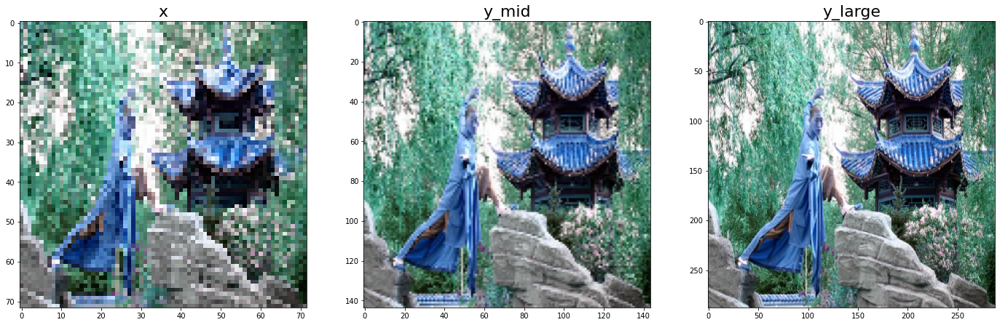

In [11]:
def get_test_image(data, index):
  img = cv2.imread(data[index])
  x=[]
  y_mid=[]
  y_large=[]
  if type(img)==np.ndarray:
    img = img /255.
    test_x = cv2.resize(img,(72,72))
    test_y_mid = cv2.resize(img,(144,144))
    test_y_large = cv2.resize(img,(288,288))
    x.append(test_x); y_mid.append(test_y_mid);y_large.append(test_y_large);
    x= np.array(x);y_mid= np.array(y_mid);y_large= np.array(y_large);
  return [x, y_mid, y_large]
test_image = get_test_image(val_data, 1000)
plot_multiple_images([test_image[0][0], test_image[1][0], test_image[2][0]],['x','y_mid','y_large'])

Above - the test image in 3 sizes for comparation with models images
Below - spliting the data set with image data generator

In [12]:
def ImageDataGenerator(images, is_large, epochs=100):
  for epoch in range(epochs):
    for i, image in enumerate(images):
      img = cv2.imread(image)
      if type(img)==np.ndarray:
        img = img /255.
        x = cv2.resize(img,(72,72))
        y_mid = cv2.resize(img,(144,144))
        if is_large:
          y_large = cv2.resize(img,(288,288))
          yield np.expand_dims(x,axis=0), [np.expand_dims(y_mid,axis=0), np.expand_dims(y_large,axis=0)]
        else:
          yield np.expand_dims(x,axis=0), np.expand_dims(y_mid,axis=0)
      else:
        error.append(image)

In [13]:
class CallbackOverride(Callback):
    def on_epoch_end(self, epoch, logs=None):
        p = self.model.predict(np.expand_dims(test_image[0][0],axis=0))
        preds_gif.append(p)

es = EarlyStopping(monitor='val_loss', verbose=1, patience=10)

In [14]:
def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303

In [15]:
tr_data_gen_mid = ImageDataGenerator(tr_data, is_large=False, epochs=N_epoches)
val_data_gen_mid = ImageDataGenerator(val_data[:-1], is_large=False, epochs=N_epoches)

#Step 2

Simple model with 1 output 144X144

In [16]:
def get_simple_conv_model():
    inp = Input(shape=(72,72,3))
    x= Conv2D(64, kernel_size=3, activation = 'relu', padding='same')(inp)
    x= Conv2D(64, kernel_size=3, activation = 'relu', padding='same')(x)
    x= UpSampling2D(size=2, interpolation='nearest')(x) # interpolation added
    x= Conv2D(3, (1,1))(x)
    x = Activation('sigmoid', name='out_144')(x)# activation changed from relu to sigmoid
    model=Model(inputs=inp, outputs=x)
    model.compile(loss='mse', optimizer='adam', metrics=[PSNR])
    return model
model = get_simple_conv_model()
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 72, 72, 3)]       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 72, 72, 64)        1792      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 72, 72, 64)        36928     
_________________________________________________________________
up_sampling2d (UpSampling2D) (None, 144, 144, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 144, 144, 3)       195       
_________________________________________________________________
out_144 (Activation)         (None, 144, 144, 3)       0         
Total params: 38,915
Trainable params: 38,915
Non-trainable params: 0
_________________________________________________________

In [17]:
preds_gif = []
history = model.fit(tr_data_gen_mid, steps_per_epoch=len(tr_data)//batch_split,validation_data=val_data_gen_mid,validation_steps=len(val_data)//batch_split,epochs=N_epoches, callbacks=[CallbackOverride(),es])
save_gif(gif_path, 'step2', preds_gif)

Epoch 1/50
502/502 [==============================] - 8s 12ms/step - loss: 0.0278 - PSNR: 21.3693 - val_loss: 0.0075 - val_PSNR: 28.1228
Epoch 2/50
502/502 [==============================] - 6s 11ms/step - loss: 0.0070 - PSNR: 28.4549 - val_loss: 0.0098 - val_PSNR: 27.6043
Epoch 3/50
502/502 [==============================] - 6s 11ms/step - loss: 0.0088 - PSNR: 28.4780 - val_loss: 0.0094 - val_PSNR: 28.2905
Epoch 4/50
502/502 [==============================] - 6s 11ms/step - loss: 0.0082 - PSNR: 28.4310 - val_loss: 0.0067 - val_PSNR: 29.2104
Epoch 5/50
502/502 [==============================] - 6s 11ms/step - loss: 0.0068 - PSNR: 30.1225 - val_loss: 0.0082 - val_PSNR: 29.5355
Epoch 6/50
502/502 [==============================] - 6s 11ms/step - loss: 0.0076 - PSNR: 29.1485 - val_loss: 0.0101 - val_PSNR: 26.3926
Epoch 7/50
502/502 [==============================] - 6s 11ms/step - loss: 0.0071 - PSNR: 28.7037 - val_loss: 0.0059 - val_PSNR: 31.0019
Epoch 8/50
502/502 [=====================

Display result:



*   loss & PSNR plots over epoches
*   Test image comparation between model's result and original image
*   Display gif - the test image changes over epoches
*   Results table - save the best score loss/PSNR for each step










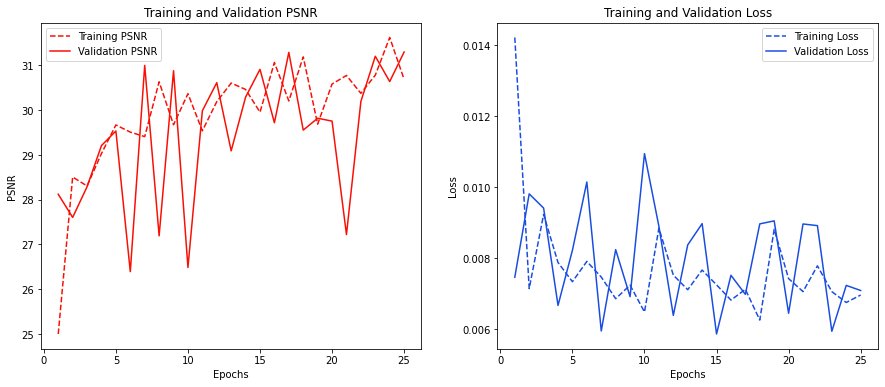

In [18]:
plot_model_144(history)

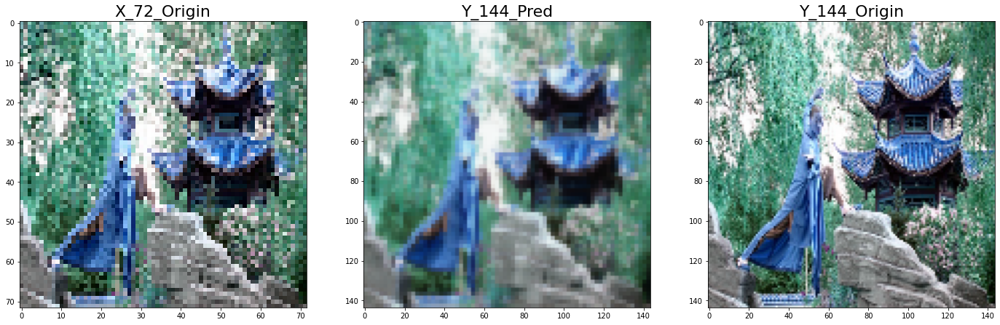

In [19]:
titles3 = ['X_72_Origin', 'Y_144_Pred', 'Y_144_Origin']
plot_multiple_images([test_image[0][0], preds_gif[-1][0], test_image[1][0]], titles3)

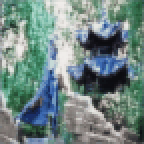

In [20]:
with open(gif_path + 'step2_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)

In [24]:
df_results = add_result(df_results, history.history, 2)
df_results

,Step,Total_val_loss,val_loss_144,val_loss_288,val_PSNR_144,val_PSNR_288
0,2,NaN,0.005861,NaN,31.301027,NaN


#Step 3

In [25]:
tr_data_gen = ImageDataGenerator(tr_data, is_large=True, epochs=N_epoches)
val_data_gen = ImageDataGenerator(val_data[:-1], is_large=True, epochs=N_epoches)

Simple model with 2 outputs 144X144, 288X288

In [26]:
def get_simple_conv_model_3():
    inp = Input(shape=(72,72,3))
    x= Conv2D(64, kernel_size=3, activation = 'relu', padding='same')(inp)
    x= Conv2D(64, kernel_size=3, activation = 'relu', padding='same')(x)
    x= UpSampling2D(size=2, interpolation='nearest')(x) # interpolation added
    x1= Conv2D(3, (1,1))(x)
    x1 = Activation('sigmoid', name='out_144')(x1)# activation changed from relu to sigmoid
    x2=UpSampling2D(size=2, interpolation='bilinear')(x) # interpolation added
    x2= Conv2D(3, (1,1))(x2)
    x2 = Activation('sigmoid', name='out_288')(x2)
    model=Model(inputs=inp, outputs=[x1,x2])
    model.compile(loss='mse', optimizer='adam', metrics=[PSNR])
    return model
model_3 = get_simple_conv_model_3()
model_3.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 72, 72, 3)]  0                                            
__________________________________________________________________________________________________
conv2d_3 (Conv2D)               (None, 72, 72, 64)   1792        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_4 (Conv2D)               (None, 72, 72, 64)   36928       conv2d_3[0][0]                   
__________________________________________________________________________________________________
up_sampling2d_1 (UpSampling2D)  (None, 144, 144, 64) 0           conv2d_4[0][0]                   
____________________________________________________________________________________________

In [27]:
preds_gif = []
history = model_3.fit(tr_data_gen, steps_per_epoch=len(tr_data)//batch_split,validation_data=val_data_gen,validation_steps=len(val_data)//batch_split,epochs=N_epoches, callbacks=[CallbackOverride(),es])
save_gifs(gif_path, 'step3', preds_gif)

Epoch 1/50
502/502 [==============================] - 8s 14ms/step - loss: 0.0535 - out_144_loss: 0.0275 - out_288_loss: 0.0260 - out_144_PSNR: 21.4876 - out_288_PSNR: 21.7121 - val_loss: 0.0144 - val_out_144_loss: 0.0077 - val_out_288_loss: 0.0067 - val_out_144_PSNR: 27.5919 - val_out_288_PSNR: 28.2257
Epoch 2/50
502/502 [==============================] - 7s 14ms/step - loss: 0.0132 - out_144_loss: 0.0070 - out_288_loss: 0.0063 - out_144_PSNR: 28.4137 - out_288_PSNR: 28.8312 - val_loss: 0.0197 - val_out_144_loss: 0.0103 - val_out_288_loss: 0.0094 - val_out_144_PSNR: 26.8531 - val_out_288_PSNR: 27.1340
Epoch 3/50
502/502 [==============================] - 7s 14ms/step - loss: 0.0171 - out_144_loss: 0.0090 - out_288_loss: 0.0081 - out_144_PSNR: 28.1354 - out_288_PSNR: 28.5758 - val_loss: 0.0182 - val_out_144_loss: 0.0096 - val_out_288_loss: 0.0086 - val_out_144_PSNR: 27.5992 - val_out_288_PSNR: 27.5997
Epoch 4/50
502/502 [==============================] - 7s 14ms/step - loss: 0.0157 - o

Display result:



*   loss & PSNR plots over epoches
*   Test image comparation between model's result and original image
*   Display gif - the test image changes over epoches
*   Results table - save the best score loss/PSNR for each step

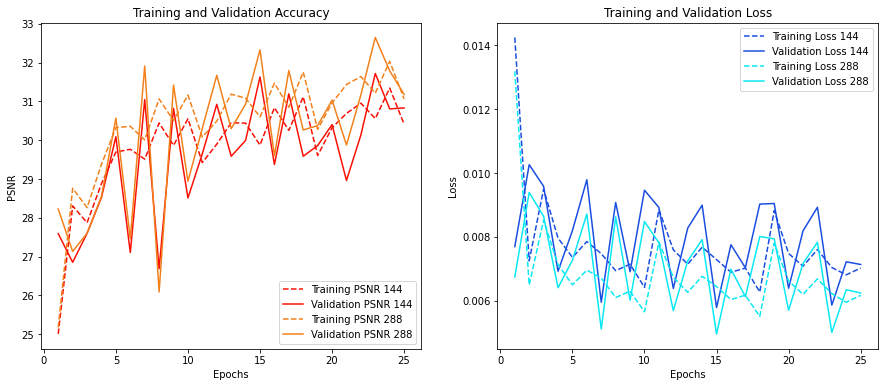

In [28]:
plot_model_288(history)

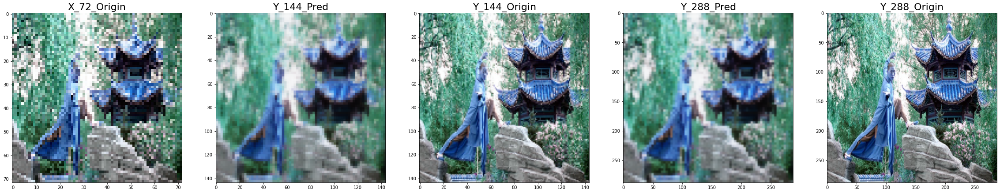

In [29]:
titles5 = ['X_72_Origin', 'Y_144_Pred', 'Y_144_Origin', 'Y_288_Pred', 'Y_288_Origin']
plot_multiple_images([test_image[0][0], preds_gif[-1][0][0], test_image[1][0], preds_gif[-1][1][0], test_image[2][0]], titles5)

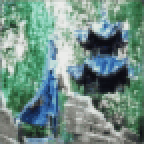

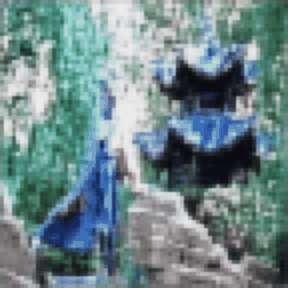

In [30]:
with open(gif_path + 'step3_144_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)
with open(gif_path + 'step3_288_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)

In [44]:
df_results = add_result(df_results, history.history, 3)
df_results

,Step,Total_val_loss,val_loss_144,val_loss_288,val_PSNR_144,val_PSNR_288
0,2.0,NaN,0.005861,NaN,31.301027,NaN
1,3.0,0.010183,0.005574,0.004609,32.147869,32.838329


# step 4

In [45]:
def get_residual_block(cnl=32):
    inp = Input(shape=(None,None,cnl))
    x= Conv2D(cnl, kernel_size=3, activation = 'relu', padding='same')(inp)
    x= Conv2D(cnl, kernel_size=3, activation = 'relu', padding='same')(x)
    x= add([x,inp])
    x=LeakyReLU(alpha=0.2)(x)
    model=Model(inputs=inp, outputs=[x])
    model.compile(loss='mse', optimizer='adam', metrics=[PSNR])
    return model
rb=get_residual_block(32)
rb.summary()

Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_18 (Conv2D)              (None, None, None, 3 9248        input_8[0][0]                    
__________________________________________________________________________________________________
conv2d_19 (Conv2D)              (None, None, None, 3 9248        conv2d_18[0][0]                  
__________________________________________________________________________________________________
add_4 (Add)                     (None, None, None, 3 0           conv2d_19[0][0]                  
                                                                 input_8[0][0]              

In this step I use residual block instead of conv2d with activation relu.
This change  make the model to be more complex,
each residual block contains 2 layers of conv2d 

In [46]:
def get_simple_conv_model_4():
    inp = Input(shape=(None,None,3))
    x = Conv2D(32,kernel_size=1, activation='relu', padding="same")(inp)
    x=get_residual_block(32)(x)
    x=get_residual_block(32)(x)
    x= UpSampling2D(size=2, interpolation='nearest')(x) # interpolation added
    x1= Conv2D(3, (1,1))(x)
    x1 = Activation('sigmoid', name='out_144')(x1)
    x2=get_residual_block(32)(x)
    x2=UpSampling2D(size=2, interpolation='bilinear')(x2) # interpolation added
    x2= Conv2D(3, (1,1))(x2)
    x2 = Activation('sigmoid', name='out_288')(x2)
    model=Model(inputs=inp, outputs=[x1,x2])
    model.compile(loss='mse', optimizer='adam', metrics=[PSNR])
    return model
model_4 = get_simple_conv_model_4()
model_4.summary()

Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_20 (Conv2D)              (None, None, None, 3 128         input_9[0][0]                    
__________________________________________________________________________________________________
model_8 (Functional)            (None, None, None, 3 18496       conv2d_20[0][0]                  
__________________________________________________________________________________________________
model_9 (Functional)            (None, None, None, 3 18496       model_8[0][0]                    
___________________________________________________________________________________________

In [47]:
preds_gif = []
history = model_4.fit(tr_data_gen, steps_per_epoch=len(tr_data)//batch_split,validation_data=val_data_gen,validation_steps=len(val_data)//batch_split,epochs=N_epoches, callbacks=[CallbackOverride(),es])
save_gifs(gif_path, 'step4', preds_gif)

Epoch 1/50
502/502 [==============================] - 8s 15ms/step - loss: 0.0536 - out_144_loss: 0.0272 - out_288_loss: 0.0265 - out_144_PSNR: 21.7425 - out_288_PSNR: 21.5196 - val_loss: 0.0399 - val_out_144_loss: 0.0164 - val_out_288_loss: 0.0235 - val_out_144_PSNR: 22.7661 - val_out_288_PSNR: 19.6651
Epoch 2/50
502/502 [==============================] - 8s 15ms/step - loss: 0.0191 - out_144_loss: 0.0097 - out_288_loss: 0.0093 - out_144_PSNR: 26.8097 - out_288_PSNR: 26.6175 - val_loss: 0.0185 - val_out_144_loss: 0.0096 - val_out_288_loss: 0.0088 - val_out_144_PSNR: 27.4472 - val_out_288_PSNR: 26.4961
Epoch 3/50
502/502 [==============================] - 7s 15ms/step - loss: 0.0159 - out_144_loss: 0.0083 - out_288_loss: 0.0076 - out_144_PSNR: 28.2702 - out_288_PSNR: 28.1635 - val_loss: 0.0141 - val_out_144_loss: 0.0074 - val_out_288_loss: 0.0067 - val_out_144_PSNR: 28.7739 - val_out_288_PSNR: 28.5685
Epoch 4/50
502/502 [==============================] - 8s 15ms/step - loss: 0.0134 - o

Display result:



*   loss & PSNR plots over epoches
*   Test image comparation between model's result and original image
*   Display gif - the test image changes over epoches
*   Results table - save the best score loss/PSNR for each step

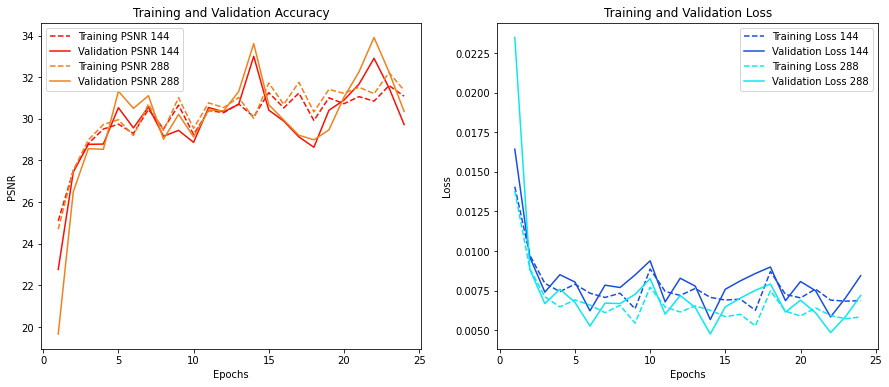

In [48]:
plot_model_288(history)

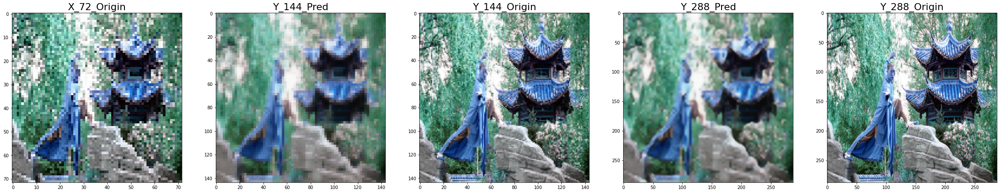

In [49]:
plot_multiple_images([test_image[0][0], preds_gif[-1][0][0], test_image[1][0], preds_gif[-1][1][0], test_image[2][0]], titles5)

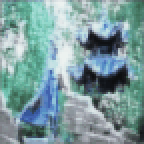

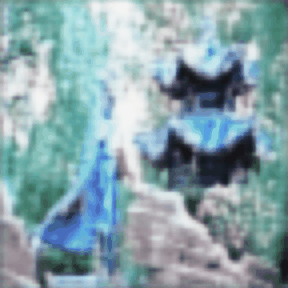

In [50]:
with open(gif_path + 'step4_144_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)
with open(gif_path + 'step4_288_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)

In [51]:
df_results = add_result(df_results, history.history, 4)
df_results

,Step,Total_val_loss,val_loss_144,val_loss_288,val_PSNR_144,val_PSNR_288
0,2.0,NaN,0.005861,NaN,31.301027,NaN
1,3.0,0.010183,0.005574,0.004609,32.147869,32.838329
2,4.0,0.010450,0.005680,0.004770,33.001179,33.906269


#Step 5

In this step I changed the residual block with dilated convolutional block.

In [52]:
def get_dilated_conv_block(cnl):
    inp = Input(shape=(None,None,cnl))
    x1= Conv2D(cnl, kernel_size=3, activation = 'relu', padding='same', dilation_rate=(1,1))(inp)
    x2= Conv2D(cnl, kernel_size=3, activation = 'relu', padding='same',dilation_rate=(2,2))(inp)
    x4= Conv2D(cnl, kernel_size=3, activation = 'relu', padding='same',dilation_rate=(4,4))(inp)
    x= concatenate([x1, x2, x4], axis=-1)
    x=LeakyReLU(alpha=0.2)(x)
    x= Conv2D(cnl, kernel_size=3, activation = 'relu', padding='same')(x)
    model=Model(inputs=inp, outputs=[x])
    model.compile(loss='mse', optimizer='adam')
    return model
rb=get_dilated_conv_block(32)
rb.summary()

Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_29 (Conv2D)              (None, None, None, 3 9248        input_13[0][0]                   
__________________________________________________________________________________________________
conv2d_30 (Conv2D)              (None, None, None, 3 9248        input_13[0][0]                   
__________________________________________________________________________________________________
conv2d_31 (Conv2D)              (None, None, None, 3 9248        input_13[0][0]                   
___________________________________________________________________________________________

In [53]:
def get_simple_conv_model_5():
    inp = Input(shape=(None,None,3))
    x = Conv2D(32,1)(inp)
    x=get_dilated_conv_block(32)(x)
    x=get_dilated_conv_block(32)(x)
    x= UpSampling2D(size=2, interpolation='nearest')(x) # interpolation added
    x1= Conv2D(3, (1,1))(x)# activation changed from relu to sigmoid
    x1 = Activation('sigmoid', name='out_144')(x1)
    x2=get_dilated_conv_block(32)(x)
    x2=UpSampling2D(size=2, interpolation='bilinear')(x2) # interpolation added
    x2=Conv2D(3, (1,1))(x2)
    x2 = Activation('sigmoid', name='out_288')(x2)
    model=Model(inputs=inp, outputs=[x1,x2])
    model.compile(loss='mse', optimizer='adam', metrics=[PSNR])
    return model
model_5 = get_simple_conv_model_5()
model_5.summary()

Model: "model_16"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_14 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_33 (Conv2D)              (None, None, None, 3 128         input_14[0][0]                   
__________________________________________________________________________________________________
model_13 (Functional)           (None, None, None, 3 55424       conv2d_33[0][0]                  
__________________________________________________________________________________________________
model_14 (Functional)           (None, None, None, 3 55424       model_13[0][0]                   
___________________________________________________________________________________________

In [54]:
preds_gif = []
history = model_5.fit(tr_data_gen, steps_per_epoch=len(tr_data)//batch_split,validation_data=val_data_gen,validation_steps=len(val_data)//batch_split,epochs=N_epoches, callbacks=[CallbackOverride(),es])
save_gifs(gif_path, 'step5', preds_gif)

Epoch 1/50
502/502 [==============================] - 11s 17ms/step - loss: 0.0700 - out_144_loss: 0.0342 - out_288_loss: 0.0358 - out_144_PSNR: 20.1917 - out_288_PSNR: 19.7932 - val_loss: 0.0235 - val_out_144_loss: 0.0114 - val_out_288_loss: 0.0121 - val_out_144_PSNR: 24.9480 - val_out_288_PSNR: 24.0369
Epoch 2/50
502/502 [==============================] - 8s 16ms/step - loss: 0.0222 - out_144_loss: 0.0109 - out_288_loss: 0.0113 - out_144_PSNR: 25.3063 - out_288_PSNR: 24.6298 - val_loss: 0.0183 - val_out_144_loss: 0.0095 - val_out_288_loss: 0.0088 - val_out_144_PSNR: 27.1400 - val_out_288_PSNR: 26.9946
Epoch 3/50
502/502 [==============================] - 8s 16ms/step - loss: 0.0177 - out_144_loss: 0.0090 - out_288_loss: 0.0087 - out_144_PSNR: 26.7835 - out_288_PSNR: 26.3158 - val_loss: 0.0154 - val_out_144_loss: 0.0080 - val_out_288_loss: 0.0074 - val_out_144_PSNR: 28.4915 - val_out_288_PSNR: 28.4607
Epoch 4/50
502/502 [==============================] - 8s 16ms/step - loss: 0.0154 - 

Display result:



*   loss & PSNR plots over epoches
*   Test image comparation between model's result and original image
*   Display gif - the test image changes over epoches
*   Results table - save the best score loss/PSNR for each step

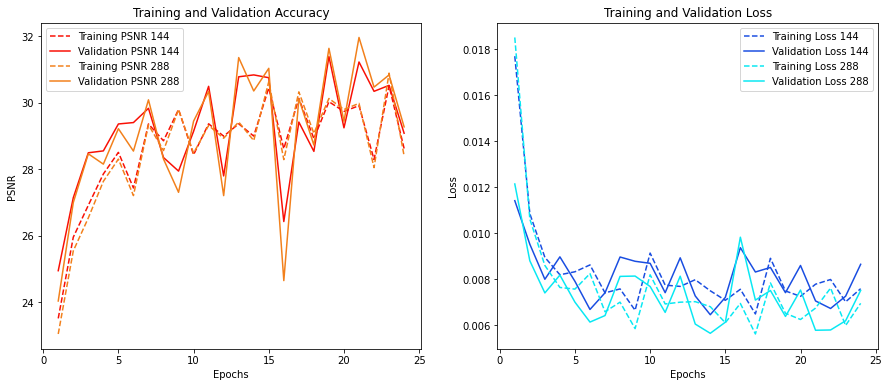

In [55]:
plot_model_288(history)

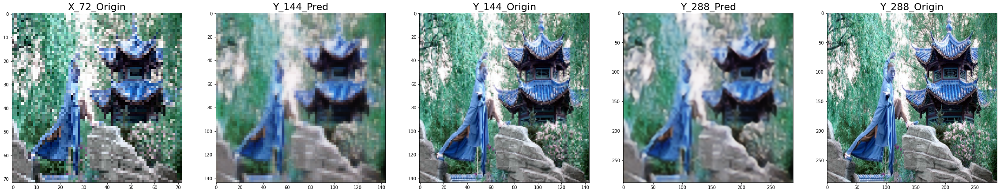

In [56]:
plot_multiple_images([test_image[0][0], preds_gif[-1][0][0], test_image[1][0], preds_gif[-1][1][0], test_image[2][0]], titles5)

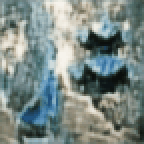

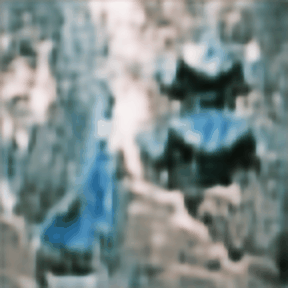

In [57]:
with open(gif_path + 'step5_144_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)
with open(gif_path + 'step5_288_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)

In [58]:
df_results = add_result(df_results, history.history, 5)
df_results

,Step,Total_val_loss,val_loss_144,val_loss_288,val_PSNR_144,val_PSNR_288
0,2.0,NaN,0.005861,NaN,31.301027,NaN
1,3.0,0.010183,0.005574,0.004609,32.147869,32.838329
2,4.0,0.010450,0.005680,0.004770,33.001179,33.906269
3,5.0,0.012081,0.006445,0.005636,31.384809,31.957260


# step 6

In this step 6 we upgrade the model from step 3 by concatenate conv2d result with feature extractor result. 
we will use the output of the third layer "block1_conv2" as second input to the concatenate operation

In [59]:
VGG16().summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_18 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [60]:
def get_N_first_Layers_vgg16( N):
    vgg = VGG16(weights='imagenet', include_top=False)
    model=Model(inputs=vgg.input, outputs=vgg.layers[N-1].output)
    model.compile(loss='mse', optimizer='adam')
    return model

In [61]:
def get_simple_conv_model_6():
    inp = Input(shape=(None,None,3))
    x1 = get_N_first_Layers_vgg16(3)(inp)
    x2= Conv2D(64, kernel_size=3, activation = 'relu', padding='same')(inp)
    x2= Conv2D(64, kernel_size=3, activation = 'relu', padding='same')(x2)
    x= concatenate([x1, x2])
    x= UpSampling2D(size=2, interpolation='nearest')(x)
    x1= Conv2D(3, (1,1), padding='same')(x)
    x1= Activation('sigmoid', name='out_144')(x1)
    x2=UpSampling2D(size=2, interpolation='nearest')(x)
    x2=Conv2D(3, (1,1), padding='same')(x2)
    x2=Activation('sigmoid', name='out_288')(x2)
    model=Model(inputs=inp, outputs=[x1,x2])
    model.compile(loss='mse', optimizer='adam', metrics=[PSNR])
    return model
model_6 = get_simple_conv_model_6()
model_6.summary()

Model: "model_18"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_48 (Conv2D)              (None, None, None, 6 1792        input_19[0][0]                   
__________________________________________________________________________________________________
model_17 (Functional)           (None, None, None, 6 38720       input_19[0][0]                   
__________________________________________________________________________________________________
conv2d_49 (Conv2D)              (None, None, None, 6 36928       conv2d_48[0][0]                  
___________________________________________________________________________________________

In [62]:
preds_gif = []
history = model_6.fit(tr_data_gen, steps_per_epoch=len(tr_data)//batch_split,validation_data=val_data_gen,validation_steps=len(val_data)//batch_split,epochs=N_epoches, callbacks=[CallbackOverride(),es])
save_gifs(gif_path, 'step6', preds_gif)

Epoch 1/50
502/502 [==============================] - 9s 16ms/step - loss: 0.0508 - out_144_loss: 0.0276 - out_288_loss: 0.0232 - out_144_PSNR: 22.4957 - out_288_PSNR: 22.7289 - val_loss: 0.0183 - val_out_144_loss: 0.0093 - val_out_288_loss: 0.0090 - val_out_144_PSNR: 27.0380 - val_out_288_PSNR: 28.1289
Epoch 2/50
502/502 [==============================] - 7s 15ms/step - loss: 0.0178 - out_144_loss: 0.0090 - out_288_loss: 0.0088 - out_144_PSNR: 27.1807 - out_288_PSNR: 27.4875 - val_loss: 0.0189 - val_out_144_loss: 0.0101 - val_out_288_loss: 0.0089 - val_out_144_PSNR: 25.2094 - val_out_288_PSNR: 27.4736
Epoch 3/50
502/502 [==============================] - 7s 15ms/step - loss: 0.0163 - out_144_loss: 0.0083 - out_288_loss: 0.0080 - out_144_PSNR: 27.7103 - out_288_PSNR: 28.4365 - val_loss: 0.0158 - val_out_144_loss: 0.0079 - val_out_288_loss: 0.0079 - val_out_144_PSNR: 29.9226 - val_out_288_PSNR: 29.4038
Epoch 4/50
502/502 [==============================] - 7s 15ms/step - loss: 0.0150 - o

Display result:



*   loss & PSNR plots over epoches
*   Test image comparation between model's result and original image
*   Display gif - the test image changes over epoches
*   Results table - save the best score loss/PSNR for each step

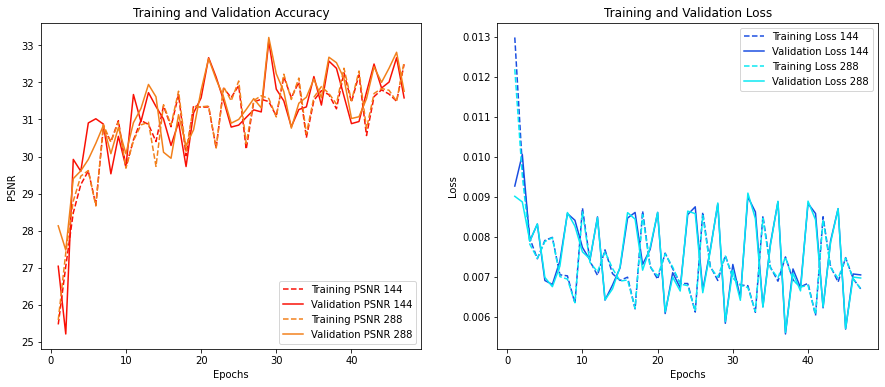

In [63]:
plot_model_288(history)

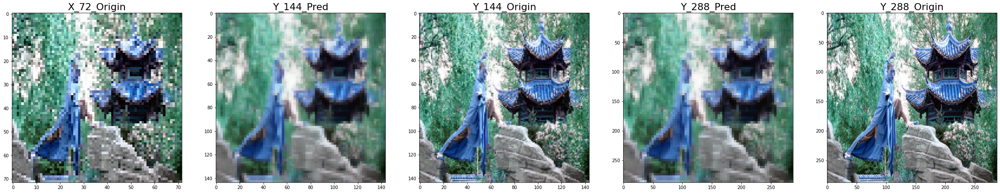

In [64]:
plot_multiple_images([test_image[0][0], preds_gif[-1][0][0], test_image[1][0], preds_gif[-1][1][0], test_image[2][0]], titles5)

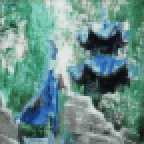

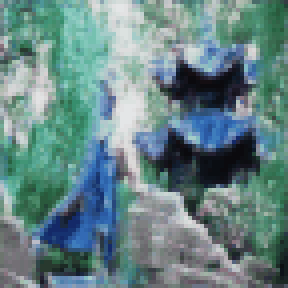

In [65]:
with open(gif_path + 'step6_144_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)
with open(gif_path + 'step6_288_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)

In [66]:
df_results = add_result(df_results, history.history, 6)
df_results

,Step,Total_val_loss,val_loss_144,val_loss_288,val_PSNR_144,val_PSNR_288
0,2.0,NaN,0.005861,NaN,31.301027,NaN
1,3.0,0.010183,0.005574,0.004609,32.147869,32.838329
2,4.0,0.010450,0.005680,0.004770,33.001179,33.906269
3,5.0,0.012081,0.006445,0.005636,31.384809,31.957260
4,6.0,0.011168,0.005566,0.005603,33.110527,33.214207


# step 7

In step 7 we upgraded step 6 by changing the Upsampling2D to depth to space

In [67]:
def get_simple_conv_model_7():
    inp = Input(shape=(None,None,3))
    x1 = get_N_first_Layers_vgg16(3)(inp)
    x2= Conv2D(64, kernel_size=3, activation = 'relu', padding='same')(inp)
    x2= Conv2D(64, kernel_size=3, activation = 'relu', padding='same')(x2)
    x= concatenate([x1, x2])
    x= depth_to_space(x,2)
    x1= Conv2D(3, (1,1), padding='same')(x)# activation changed from relu to sigmoid
    x1= Activation('sigmoid', name='out_144')(x1)
    x2= depth_to_space(x,2)
    x2=Conv2D(3, (1,1), padding='same')(x2)
    x2=Activation('sigmoid', name='out_288')(x2)
    model=Model(inputs=inp, outputs=[x1,x2])
    model.compile(loss='mse', optimizer='adam', metrics=[PSNR])
    return model
model_7 = get_simple_conv_model_7()
model_7.summary()

Model: "model_20"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_21 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_52 (Conv2D)              (None, None, None, 6 1792        input_21[0][0]                   
__________________________________________________________________________________________________
model_19 (Functional)           (None, None, None, 6 38720       input_21[0][0]                   
__________________________________________________________________________________________________
conv2d_53 (Conv2D)              (None, None, None, 6 36928       conv2d_52[0][0]                  
___________________________________________________________________________________________

In [68]:
preds_gif = []
history = model_7.fit(tr_data_gen, steps_per_epoch=len(tr_data)//batch_split,validation_data=val_data_gen,validation_steps=len(val_data)//batch_split,epochs=N_epoches, callbacks=[CallbackOverride(),es])
save_gifs(gif_path, 'step7', preds_gif)

Epoch 1/50
502/502 [==============================] - 8s 14ms/step - loss: 0.0982 - out_144_loss: 0.0379 - out_288_loss: 0.0603 - out_144_PSNR: 19.6583 - out_288_PSNR: 16.5464 - val_loss: 0.0238 - val_out_144_loss: 0.0109 - val_out_288_loss: 0.0129 - val_out_144_PSNR: 25.1091 - val_out_288_PSNR: 23.8859
Epoch 2/50
502/502 [==============================] - 7s 14ms/step - loss: 0.0157 - out_144_loss: 0.0068 - out_288_loss: 0.0089 - out_144_PSNR: 27.5347 - out_288_PSNR: 25.6110 - val_loss: 0.0201 - val_out_144_loss: 0.0099 - val_out_288_loss: 0.0102 - val_out_144_PSNR: 26.5792 - val_out_288_PSNR: 26.0711
Epoch 3/50
502/502 [==============================] - 7s 14ms/step - loss: 0.0174 - out_144_loss: 0.0084 - out_288_loss: 0.0091 - out_144_PSNR: 27.6409 - out_288_PSNR: 26.8812 - val_loss: 0.0145 - val_out_144_loss: 0.0072 - val_out_288_loss: 0.0073 - val_out_144_PSNR: 27.3494 - val_out_288_PSNR: 27.7856
Epoch 4/50
502/502 [==============================] - 7s 14ms/step - loss: 0.0166 - o

Display result:



*   loss & PSNR plots over epoches
*   Test image comparation between model's result and original image
*   Display gif - the test image changes over epoches
*   Results table - save the best score loss/PSNR for each step

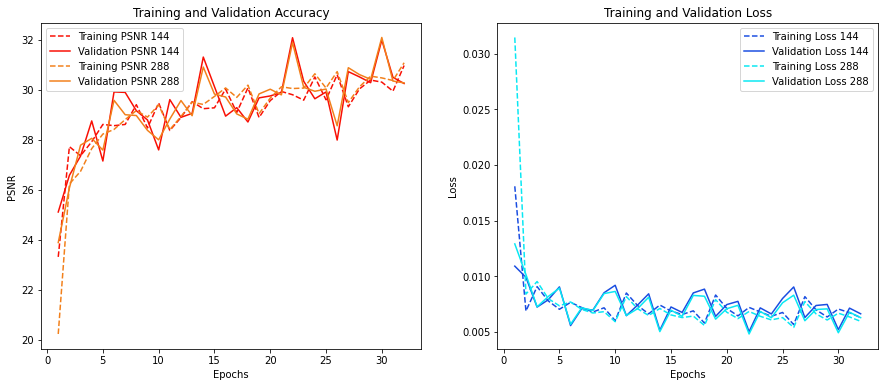

In [69]:
plot_model_288(history)

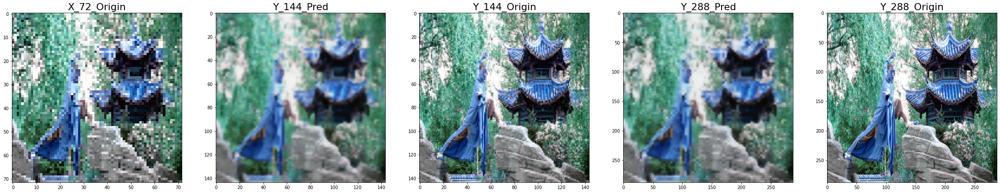

In [70]:
plot_multiple_images([test_image[0][0], preds_gif[-1][0][0], test_image[1][0], preds_gif[-1][1][0], test_image[2][0]], titles5)

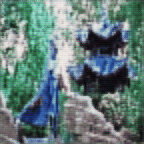

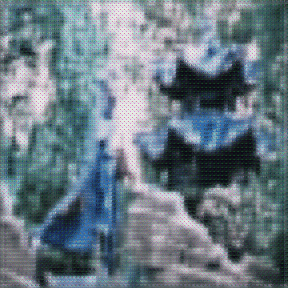

In [71]:
with open(gif_path + 'step7_144_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)
with open(gif_path + 'step7_288_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)

In [72]:
df_results = add_result(df_results, history.history, 7)
df_results

,Step,Total_val_loss,val_loss_144,val_loss_288,val_PSNR_144,val_PSNR_288
0,2.0,NaN,0.005861,NaN,31.301027,NaN
1,3.0,0.010183,0.005574,0.004609,32.147869,32.838329
2,4.0,0.010450,0.005680,0.004770,33.001179,33.906269
3,5.0,0.012081,0.006445,0.005636,31.384809,31.957260
4,6.0,0.011168,0.005566,0.005603,33.110527,33.214207
5,7.0,0.009833,0.005019,0.004814,32.087196,32.097446


## Comparing Results :

   from the results its easy to see that the best models by loss metrics are step 4 model and step 7 model
  to improve the loss metrics, i will build a model that combine both - with residuals block and depth to space

#Step 8

My Model - with residual blocks and depth to space

In [73]:
def get_simple_conv_model_8():
    inp = Input(shape=(None,None,3))
    x1 = get_N_first_Layers_vgg16(3)(inp)
    x2 = Conv2D(64, kernel_size=1, activation=LeakyReLU(alpha=0.2), padding="same")(inp)
    x2= get_residual_block(64)(x2)
    x2=get_residual_block(64)(x2)
    x= concatenate([x1, x2])
    x= depth_to_space(x,2)
    x1= Conv2D(3, (1,1), padding='same')(x)# activation changed from relu to sigmoid
    x1= Activation('sigmoid', name='out_144')(x1)
    x2= depth_to_space(x,2)
    x2=Conv2D(3, (1,1), padding='same')(x2)
    x2=Activation('sigmoid', name='out_288')(x2)
    model=Model(inputs=inp, outputs=[x1,x2])
    model.compile(loss='mse', optimizer='adam', metrics=[PSNR])
    return model
model_8 = get_simple_conv_model_8()
model_8.summary()

Model: "model_24"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_23 (InputLayer)           [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_56 (Conv2D)              (None, None, None, 6 256         input_23[0][0]                   
__________________________________________________________________________________________________
model_22 (Functional)           (None, None, None, 6 73856       conv2d_56[0][0]                  
__________________________________________________________________________________________________
model_21 (Functional)           (None, None, None, 6 38720       input_23[0][0]                   
___________________________________________________________________________________________

In [74]:
preds_gif = []
history = model_8.fit(tr_data_gen, steps_per_epoch=len(tr_data)//batch_split,validation_data=val_data_gen,validation_steps=len(val_data)//batch_split,epochs=N_epoches, callbacks=[CallbackOverride(),es])
save_gifs(gif_path, 'step8', preds_gif)

Epoch 1/50
502/502 [==============================] - 8s 15ms/step - loss: 0.1014 - out_144_loss: 0.0404 - out_288_loss: 0.0609 - out_144_PSNR: 19.5251 - out_288_PSNR: 16.5015 - val_loss: 0.0245 - val_out_144_loss: 0.0097 - val_out_288_loss: 0.0149 - val_out_144_PSNR: 26.7921 - val_out_288_PSNR: 23.8934
Epoch 2/50
502/502 [==============================] - 7s 14ms/step - loss: 0.0191 - out_144_loss: 0.0070 - out_288_loss: 0.0122 - out_144_PSNR: 27.2658 - out_288_PSNR: 24.3940 - val_loss: 0.0331 - val_out_144_loss: 0.0169 - val_out_288_loss: 0.0162 - val_out_144_PSNR: 22.8987 - val_out_288_PSNR: 22.5845
Epoch 3/50
502/502 [==============================] - 7s 15ms/step - loss: 0.0213 - out_144_loss: 0.0093 - out_288_loss: 0.0120 - out_144_PSNR: 26.4614 - out_288_PSNR: 24.3342 - val_loss: 0.0155 - val_out_144_loss: 0.0070 - val_out_288_loss: 0.0085 - val_out_144_PSNR: 29.1427 - val_out_288_PSNR: 27.0752
Epoch 4/50
502/502 [==============================] - 7s 14ms/step - loss: 0.0174 - o

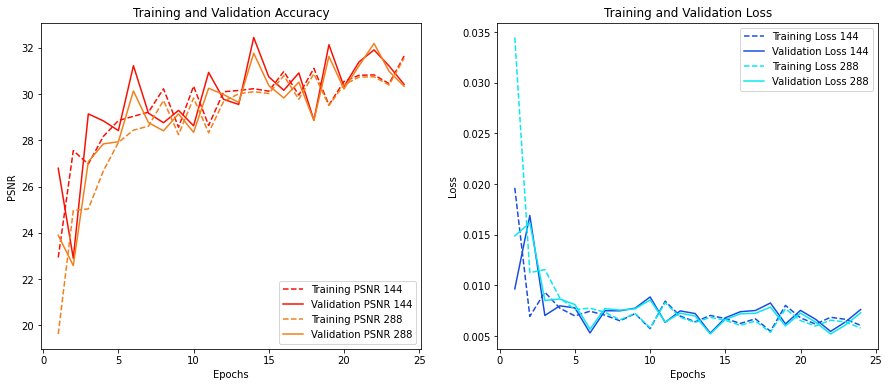

In [75]:
plot_model_288(history)

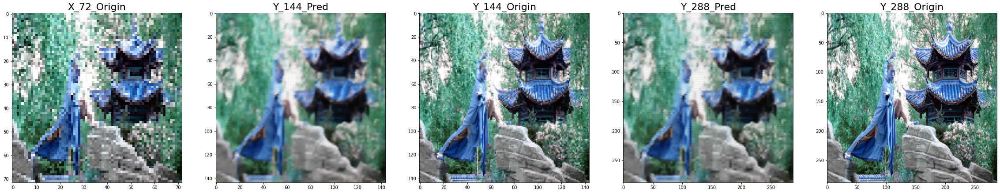

In [76]:
plot_multiple_images([test_image[0][0], preds_gif[-1][0][0], test_image[1][0], preds_gif[-1][1][0], test_image[2][0]], titles5)

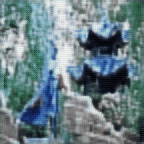

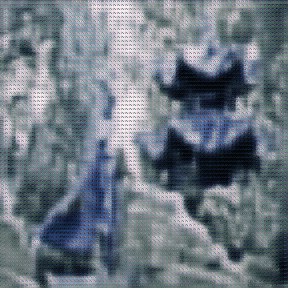

In [77]:
with open(gif_path + 'step8_144_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)
with open(gif_path + 'step8_288_mygif.gif','rb') as f:
    display.Image(data=f.read(), format='png', width = 300, height = 300)

In [78]:
df_results = add_result(df_results, history.history, 8)
df_results

,Step,Total_val_loss,val_loss_144,val_loss_288,val_PSNR_144,val_PSNR_288
0,2.0,NaN,0.005861,NaN,31.301027,NaN
1,3.0,0.010183,0.005574,0.004609,32.147869,32.838329
2,4.0,0.010450,0.005680,0.004770,33.001179,33.906269
3,5.0,0.012081,0.006445,0.005636,31.384809,31.957260
4,6.0,0.011168,0.005566,0.005603,33.110527,33.214207
5,7.0,0.009833,0.005019,0.004814,32.087196,32.097446
6,8.0,0.010487,0.005284,0.005202,32.447662,32.188358


Our results shows that model 8 didn't improve the resluts of the previous steps
In each step we can see the test images over the steps compares to the original images. also we can compare the gifs over the steps to compare resluts.